In [1]:
!pip install gymnasium

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.9/953.9 kB 5.4 MB/s eta 0:00:00


/usr/local/lib/python3.10/dist-packages/imageio/plugins/pillow.py:390: DeprecationWarning: The keyword `fps` is no longer supported. Use `duration`(in ms) instead, e.g. `fps=50` == `duration=20` (1000 * 1/50).
  warnings.warn(


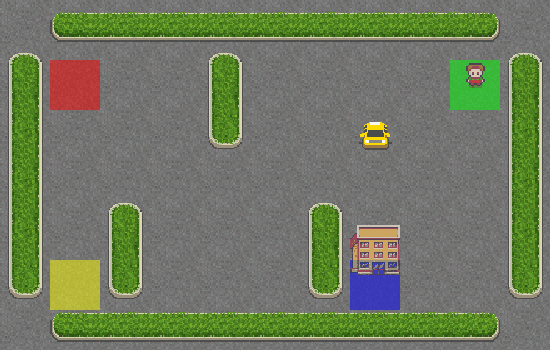

In [5]:
import numpy as np
import gymnasium as gym
import imageio
from IPython.display import Image

env = gym.make("Taxi-v3", render_mode='rgb_array')

def update_q_table(state, action, reward, next_state):
    old_value = q_table[state, action]
    next_max = max(q_table[next_state])
    q_table[state, action] = (1 - alpha) * old_value + alpha * (reward + gamma * next_max)

def epsilon_greedy(state):
    if np.random.rand() < epsilon:
        action = env.action_space.sample()
    else:
        action = np.argmax(q_table[state, :])
    return action

max_actions = 100
num_episodes = 2000
alpha = 0.1
gamma = 1
epsilon = 1
epsilon_decay = 0.99
min_epsilon = 0.01

num_states, num_actions = env.observation_space.n, env.action_space.n
q_table = np.zeros((num_states, num_actions))
episode_returns = []

for episode in range(num_episodes):
    state, info = env.reset()
    done = False
    episode_reward = 0
    time_steps = 0

    while not done:

        if time_steps > max_actions:
            break

        action = epsilon_greedy(state)
        next_state, reward, terminated, truncated, info = env.step(action)
        done = terminated or truncated
        update_q_table(state, action, reward, next_state)
        episode_reward += reward
        state = next_state
        time_steps += 1

    episode_returns.append(episode_reward)
    epsilon = max(min_epsilon, epsilon*epsilon_decay)

policy = {state: np.argmax(q_table[state]) for state in range(num_states)}

frames = []
episode_total_reward = 0
time_steps = 0
display_episodes = 20

for epsiode in range(display_episodes):

    done = False
    state, info = env.reset()
    frames.append(env.render())

    while not done:

        action = policy[state]
        next_state, reward, terminated, truncated, info = env.step(action)
        episode_total_reward += reward
        if state != next_state:
            frames.append(env.render())
        else:
            next_state, info = env.reset()
        state = next_state
        time_steps += 1

        done = terminated or truncated



imageio.mimsave('taxi_agent_behavior.gif', frames, fps=5)

gif_path = "taxi_agent_behavior.gif"
Image(gif_path)

In [ ]:
import numpy as np
import imageio
from IPython.display import Image
import matplotlib.pyplot as plt


class TrafficEnvironment:
    def __init__(self, num_stations):
        self.num_stations = num_stations
        self.vehicle_position = 0  # Initial position of the vehicle
        self.station_statuses = np.zeros(num_stations)  # Status of each station (e.g., number of vehicles waiting)

        # Define action space (0 - move forward, 1 - change lane, 2 - wait at station)
        self.action_space = [0, 1, 2]

        # Initialize Q-table with zeros
        self.q_table = np.zeros((num_stations + 1, len(self.action_space)))

    def step(self, action):
        # Simulate the vehicle's actions and update the environment's state
        if action == 0:  # Move forward
            self.vehicle_position = min(self.vehicle_position + 1, self.num_stations)
        elif action == 1:  # Change lane
            # Implement lane change logic if needed
            pass
        elif action == 2:  # Wait at station
            self.station_statuses[self.vehicle_position] += 1

        # Determine reward based on action and current state
        reward = self.get_reward(action)

        # Check termination condition (e.g., reaching a certain number of stations)
        done = self.vehicle_position == self.num_stations

        return (self.vehicle_position, tuple(self.station_statuses)), reward, done

    def get_reward(self, action):
        # Define reward structure based on the vehicle's actions and state of the environment
        # Example: negative reward for waiting in traffic, positive reward for reaching a station
        # You can customize this based on your problem domain
        pass

    def update_q_table(self, state, action, reward, next_state, alpha, gamma):
        # Convert state tuple to tuple of integers for indexing
        state_index = (int(state[0]), *state[1])  # unpack station statuses directly
        next_state_index = (int(next_state[0]), *next_state[1])

        # Update Q-values based on Q-learning update rule
        old_value = self.q_table[state_index][action]
        next_max = np.max(self.q_table[next_state_index])
        self.q_table[state_index][action] = (1 - alpha) * old_value + alpha * (reward + gamma * next_max)

    def train(self, num_episodes, alpha, gamma, epsilon, epsilon_decay=0.99, min_epsilon=0.01):
        episode_returns = []
        for episode in range(num_episodes):
            state = (self.vehicle_position, tuple(self.station_statuses))
            episode_reward = 0
            done = False
            while not done:
                # Epsilon-greedy action selection
                if np.random.rand() < epsilon:
                    action = np.random.choice(self.action_space)
                else:
                    action = np.argmax(self.q_table[state])

                # Perform action and observe next state and reward
                next_state, reward, done = self.step(action)

                # Update Q-table
                self.update_q_table(state, action, reward, next_state, alpha, gamma)

                state = next_state
                episode_reward += reward

            # Update epsilon
            epsilon = max(min_epsilon, epsilon * epsilon_decay)

            episode_returns.append(episode_reward)

        return episode_returns

    def visualize_traffic(self, gif_path, display_episodes=20, fps=5):
        frames = []
        for _ in range(display_episodes):
            state = (0, tuple(np.zeros(self.num_stations)))
            done = False
            while not done:
                action = np.argmax(self.q_table[state])
                next_state, _, done = self.step(action)
                frames.append(self.render_traffic())
                state = next_state
        imageio.mimsave(gif_path, frames, fps=fps)
        return gif_path



def render_traffic(self):
  # Create a figure and axis
  plt.figure(figsize=(8, 5))
  ax = plt.axes()

  # Plot the road as a line
  road_y = 0.5
  road_width = 0.2
  plt.plot([0, self.num_stations], [road_y, road_y], color='black', linewidth=road_width)

  # Plot the vehicle as a circle
  vehicle_pos = self.vehicle_position
  vehicle_color = 'blue' if self.vehicle_position == self.num_stations else 'red'
  plt.plot(vehicle_pos, road_y + road_width/2, marker='o', markersize=50, color=vehicle_color)

  # Plot rectangles for stations with congestion
  for i, status in enumerate(self.station_statuses):
    if status > 0:
      station_pos = i
      station_width = 0.3
      station_height = status
      plt.plot([station_pos - station_width/2, station_pos + station_width/2],
               [road_y - station_height, road_y - station_height], color='gray')

  # Set axis limits and labels
  plt.xlim(-1, self.num_stations + 1)
  plt.ylim(road_y - road_width - 1, road_y + road_width + 1)
  plt.xlabel('Station Number')

  # Display the plot (you can save it as an image if needed)
  plt.show()




In [ ]:
import numpy as np
import imageio
from IPython.display import Image

class TrafficEnvironment:
    def __init__(self, num_stations):
        self.num_stations = num_stations
        self.vehicle_position = 0  # Initial position of the vehicle
        self.station_statuses = np.zeros(num_stations)  # Status of each station (e.g., number of vehicles waiting)

        # Define action space (0 - move forward, 1 - change lane, 2 - wait at station)
        self.action_space = [0, 1, 2]

        # Initialize Q-table with zeros
        self.q_table = np.zeros((num_stations + 1, num_stations + 1, len(self.action_space)))

    def step(self, action):
        # Simulate the vehicle's actions and update the environment's state
        if action == 0:  # Move forward
            self.vehicle_position = min(self.vehicle_position + 1, self.num_stations)
        elif action == 1:  # Change lane
            # Implement lane change logic if needed
            pass
        elif action == 2:  # Wait at station
            self.station_statuses[self.vehicle_position] += 1

        # Determine reward based on action and current state
        reward = self.get_reward(action)

        # Check termination condition (e.g., reaching a certain number of stations)
        done = self.vehicle_position == self.num_stations

        return (self.vehicle_position, tuple(self.station_statuses)), reward, done

    def get_reward(self, action):
        # Define reward structure based on the vehicle's actions and state of the environment
        # Example: negative reward for waiting in traffic, positive reward for reaching a station
        # You can customize this based on your problem domain
        pass

    def update_q_table(self, state, action, reward, next_state, alpha, gamma):

        # Convert state tuple to tuple of integers for indexing
        state_index = (int(state[0]),) + tuple(map(int, state[1]))
        next_state_index = (int(next_state[0]),) + tuple(map(int, next_state[1]))

        # Update Q-values based on Q-learning update rule
        old_value = self.q_table[state_index][action]
        next_max = np.max(self.q_table[next_state_index])
        self.q_table[state_index][action] = (1 - alpha) * old_value + alpha * (reward + gamma * next_max)



    def train(self, num_episodes, alpha, gamma, epsilon, epsilon_decay=0.99, min_epsilon=0.01):
        episode_returns = []
        for episode in range(num_episodes):
            state = (self.vehicle_position, tuple(self.station_statuses))
            episode_reward = 0
            done = False
            while not done:
                # Epsilon-greedy action selection
                if np.random.rand() < epsilon:
                    action = np.random.choice(self.action_space)
                else:
                    action = np.argmax(self.q_table[state])

                # Perform action and observe next state and reward
                next_state, reward, done = self.step(action)

                # Update Q-table
                self.update_q_table(state, action, reward, next_state, alpha, gamma)

                state = next_state
                episode_reward += reward

            # Update epsilon
            epsilon = max(min_epsilon, epsilon * epsilon_decay)

            episode_returns.append(episode_reward)

        return episode_returns

    def visualize_traffic(self, gif_path, display_episodes=20, fps=5):
        frames = []
        for _ in range(display_episodes):
            state = (0, tuple(np.zeros(self.num_stations)))
            done = False
            while not done:
                action = np.argmax(self.q_table[state])
                next_state, _, done = self.step(action)
                frames.append(self.render_traffic())
                state = next_state
        imageio.mimsave(gif_path, frames, fps=fps)
        return gif_path

    def render_traffic(self):
        # Implement visualization of the traffic scenario
        # You can create a visualization based on the vehicle's position and the traffic at each station
        pass

# Example usage:
num_stations = 5
env = TrafficEnvironment(num_stations)

# Train the agent
num_episodes = 2000
alpha = 0.1
gamma = 1
epsilon = 1
episode_returns = env.train(num_episodes, alpha, gamma, epsilon)

# Visualize traffic behavior
gif_path = "traffic_agent_behavior.gif"
env.visualize_traffic(gif_path)
Image(gif_path)


IndexError: too many indices for array: array is 3-dimensional, but 6 were indexed

In [ ]:
import numpy as np
import imageio
from IPython.display import Image
import matplotlib.pyplot as plt


class TrafficEnvironment:
    def __init__(self, num_stations):
        self.num_stations = num_stations
        self.vehicle_position = 0  # Initial position of the vehicle
        self.station_statuses = np.zeros(num_stations)  # Status of each station (e.g., number of vehicles waiting)

        # Define action space (0 - move forward, 1 - change lane, 2 - wait at station)
        self.action_space = [0, 1, 2]

        # Initialize Q-table with zeros (state, action)
        self.q_table = np.zeros((num_stations + 1, len(self.action_space)))

    def step(self, action):
        # Simulate the vehicle's actions and update the environment's state
        if action == 0:  # Move forward
            self.vehicle_position = min(self.vehicle_position + 1, self.num_stations - 1)  # Adjusting the upper bound
        elif action == 1:  # Change lane
            # Implement lane change logic if needed
            pass
        elif action == 2:  # Wait at station
            self.station_statuses[self.vehicle_position] += 1

    # Determine reward based on action and current state
        reward = self.get_reward(action)

    # Check termination condition (e.g., reaching a certain number of stations)
        done = self.vehicle_position == self.num_stations - 1  # Adjusting the termination condition

        return (self.vehicle_position, tuple(self.station_statuses)), reward, done


    def get_reward(self, action):
        # Define reward structure based on the vehicle's actions and state of the environment
        reward = -1  # Base reward for each step (penalty for time spent)
        if action == 2:  # Waiting at station (penalty for congestion)
            reward -= 2
        elif action == 0 and self.station_statuses[self.vehicle_position] > 0:
            # Reward for moving forward from a congested station
            reward += 1
        elif action == 0 and self.vehicle_position == self.num_stations:
            # High reward for reaching the destination station
            reward = 10
        return reward

    def update_q_table(self, state, action, reward, next_state, alpha, gamma):
        # Convert state tuple to a single integer for indexing
        state_index = state[0]

    # Convert next_state tuple to a single integer for indexing
        next_state_index = next_state[0]

    # Update Q-values based on Q-learning update rule
        old_value = self.q_table[state_index][action]
        next_max = np.max(self.q_table[next_state_index])
        self.q_table[state_index][action] = (1 - alpha) * old_value + alpha * (reward + gamma * next_max)




    def train(self, num_episodes, alpha, gamma, epsilon, epsilon_decay=0.99, min_epsilon=0.01):
        episode_returns = []
        for episode in range(num_episodes):
            state = (self.vehicle_position, tuple(self.station_statuses))
            episode_reward = 0
            done = False
            while not done:
                # Epsilon-greedy action selection
                if np.random.rand() < epsilon:
                    action = np.random.choice(self.action_space)
                else:
                    action = np.argmax(self.q_table[state])

                # Perform action and observe next state and reward
                next_state, reward, done = self.step(action)

                # Update Q-table
                self.update_q_table(state, action, reward, next_state, alpha, gamma)

                state = next_state
                episode_reward += reward

            # Update epsilon
            epsilon = max(min_epsilon, epsilon * epsilon_decay)

            episode_returns.append(episode_reward)

        return episode_returns

    def visualize_traffic(self, gif_path, display_episodes=20, fps=5):
        frames = []
        for _ in range(display_episodes):
            state = (0, tuple(np.zeros(self.num_stations)))
            done = False
            while not done:
                action = np.argmax(self.q_table[state])
                next_state, _, done = self.step(action)
                frames.append(self.render_traffic(state))  # Pass current state for visualization
                state = next_state
        imageio.mimsave(gif_path, frames, fps=fps)
        return gif_path

    def render_traffic(self, state):
        # Create a figure and axis
        plt.figure(figsize=(8, 5))
        ax = plt.axes()

        # Plot the road as a line
        road_y = 0.5
        road_width = 0.2
        plt.plot([0, self.num_stations], [road_y, road_y], color='black', linewidth=road_width)

        # Plot the vehicle as a circle
        vehicle_pos = state[0]
        vehicle_color = 'blue' if vehicle_pos == self.num_stations else 'red'
        plt.plot(vehicle_pos, road_y + road_width/2, marker='o', markersize=50, color=vehicle_color)

        # Plot rectangles for stations with congestion
        for i, status in enumerate(state[1]):
            if status > 0:
                station_pos = i
                station_width = 0.3
                station_height = min(status, 5)  # Limit congestion height for better visualization
                plt.plot([station_pos - station_width/2, station_pos + station_width/2],
                         [road_y - station_height, road_y - station_height], color='gray')

        # Set axis limits and labels
        plt.xlim(-1, self.num_stations + 1)
        plt.ylim(road_y - road_width - 1, road_y + road_width + 1)
        plt.xlabel('Station Number')
        plt.ylabel('Congestion Level')

        # Display the plot briefly and clear the figure (to avoid multiple plots in the GIF)
        plt.show(block=False)
        plt.pause(0.1)
        plt.close()

        return None  # No return value needed for visualization




In [ ]:
import numpy as np

# Define number of stations
num_stations = 5

# Create the traffic environment
env = TrafficEnvironment(num_stations)

# Training parameters (adjust these as needed)
num_episodes = 1000
alpha = 0.1  # Learning rate
gamma = 0.9  # Discount factor
epsilon = 1.0  # Exploration rate (decays over time)
epsilon_decay = 0.99
min_epsilon = 0.01
def train(self, num_episodes, alpha, gamma, epsilon, epsilon_decay=0.99, min_epsilon=0.01):
    episode_returns = []
    for episode in range(num_episodes):
        state = (self.vehicle_position, tuple(self.station_statuses))
        episode_reward = 0
        done = False
        while not done:
            # Convert state tuple to a single integer index
            state_index = state[0]  # Assuming state[0] represents the vehicle position

            # Epsilon-greedy action selection
            if np.random.rand() < epsilon:
                action = np.random.choice(self.action_space)
            else:
                action = np.argmax(self.q_table[state_index])

            # Perform action and observe next state and reward
            next_state, reward, done = self.step(action)

            # Convert next state tuple to a single integer index
            next_state_index = next_state[0]  # Assuming next_state[0] represents the vehicle position

            # Update Q-table
            old_value = self.q_table[state_index][action]
            next_max = np.max(self.q_table[next_state_index])
            self.q_table[state_index][action] = (1 - alpha) * old_value + alpha * (reward + gamma * next_max)

            state = next_state
            episode_reward += reward

        # Update epsilon
        epsilon = max(min_epsilon, epsilon * epsilon_decay)

        episode_returns.append(episode_reward)

    return episode_returns


# Train the agent
episode_returns = env.train(num_episodes, alpha, gamma, epsilon, epsilon_decay, min_epsilon)

# Print training results (optional)
print(f"Average episode return after training: {np.mean(episode_returns)}")

# Visualization parameters
gif_path = "traffic_simulation.gif"
display_episodes = 20
fps = 5

# Generate and save the visualization GIF
env.visualize_traffic(gif_path, display_episodes, fps)

print(f"Visualization saved as: {gif_path}")


IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [ ]:
import numpy as np
import imageio
import matplotlib.pyplot as plt

class TrafficEnvironment:
    def __init__(self, num_stations):
        self.num_stations = num_stations
        self.vehicle_position = 0  # Initial position of the vehicle
        self.station_statuses = np.zeros(num_stations)  # Status of each station (e.g., number of vehicles waiting)

        # Define action space (0 - move forward, 1 - change lane, 2 - wait at station)
        self.action_space = [0, 1, 2]

        # Initialize Q-table with zeros (state, action)
        self.q_table = np.zeros((num_stations + 1, len(self.action_space)))

    def step(self, action):
        # Simulate the vehicle's actions and update the environment's state
        if action == 0:  # Move forward
            self.vehicle_position = min(self.vehicle_position + 1, self.num_stations - 1)  # Adjusting the upper bound
        elif action == 1:  # Change lane
            # Implement lane change logic if needed
            pass
        elif action == 2:  # Wait at station
            self.station_statuses[self.vehicle_position] += 1

        # Determine reward based on action and current state
        reward = self.get_reward(action)

        # Check termination condition (e.g., reaching a certain number of stations)
        done = self.vehicle_position == self.num_stations - 1  # Adjusting the termination condition

        return (self.vehicle_position, tuple(self.station_statuses)), reward, done

    def get_reward(self, action):
        # Define reward structure based on the vehicle's actions and state of the environment
        reward = -1  # Base reward for each step (penalty for time spent)
        if action == 2:  # Waiting at station (penalty for congestion)
            reward -= 2
        elif action == 0 and self.station_statuses[self.vehicle_position] > 0:
            # Reward for moving forward from a congested station
            reward += 1
        elif action == 0 and self.vehicle_position == self.num_stations:
            # High reward for reaching the destination station
            reward = 10
        return reward

    def update_q_table(self, state, action, reward, next_state, alpha, gamma):
        # Convert state tuple to a single integer for indexing
        state_index = state[0]

        # Convert next_state tuple to a single integer for indexing
        next_state_index = next_state[0]

        # Update Q-values based on Q-learning update rule
        old_value = self.q_table[state_index][action]
        next_max = np.max(self.q_table[next_state_index])
        self.q_table[state_index][action] = (1 - alpha) * old_value + alpha * (reward + gamma * next_max)

    def train(self, num_episodes, alpha, gamma, epsilon, epsilon_decay=0.99, min_epsilon=0.01):
        episode_returns = []
        for episode in range(num_episodes):
            state = (self.vehicle_position, tuple(self.station_statuses))
            episode_reward = 0
            done = False
            while not done:
                # Epsilon-greedy action selection
                if np.random.rand() < epsilon:
                    action = np.random.choice(self.action_space)
                else:
                    action = np.argmax(self.q_table[state[0]])  # Indexing using vehicle position

                # Perform action and observe next state and reward
                next_state, reward, done = self.step(action)

                # Update Q-table
                self.update_q_table(state, action, reward, next_state, alpha, gamma)

                state = next_state
                episode_reward += reward

            # Update epsilon
            epsilon = max(min_epsilon, epsilon * epsilon_decay)

            episode_returns.append(episode_reward)

        return episode_returns

    def visualize_traffic(self, gif_path, display_episodes=20, fps=5):
        frames = []
        for _ in range(display_episodes):
            state = (0, tuple(np.zeros(self.num_stations)))
            done = False
            while not done:
                action = np.argmax(self.q_table[state])
                next_state, _, done = self.step(action)
                frames.append(self.render_traffic(state))  # Pass current state for visualization
                state = next_state

        imageio.mimsave(gif_path, frames, fps=fps)
        return gif_path


    def render_traffic(self, state):
        # Create a figure and axis
        plt.figure(figsize=(8, 5))
        ax = plt.axes()

        # Plot the road as a line
        road_y = 0.5
        road_width = 0.2
        plt.plot([0, self.num_stations], [road_y, road_y], color='black', linewidth=road_width)

        # Plot the vehicle as a circle
        vehicle_pos = state[0]
        vehicle_color = 'blue' if vehicle_pos == self.num_stations else 'red'
        plt.plot(vehicle_pos, road_y + road_width/2, marker='o', markersize=50, color=vehicle_color)

        # Plot rectangles for stations with congestion
        for i, status in enumerate(state[1]):
            if status > 0:
                station_pos = i
                station_width = 0.3
                station_height = min(status, 5)  # Limit congestion height for better visualization
                plt.plot([station_pos - station_width/2, station_pos + station_width/2],
                         [road_y - station_height, road_y - station_height], color='gray')

        # Set axis limits and labels
        plt.xlim(-1, self.num_stations + 1)
        plt.ylim(road_y - road_width - 1, road_y + road_width + 1)
        plt.xlabel('Station Number')
        plt.ylabel('Congestion Level')

        # Convert plot to numpy array
        plt.tight_layout()
        plt.savefig('temp.png')
        img = plt.imread('temp.png')
        plt.close()

        return img


IndentationError: unexpected indent (<ipython-input-6-52c000647938>, line 111)

NameError: name 'img' is not defined